# Reconocimiento de productos de supermercado

In [2]:
import os
import numpy as np
from matplotlib import pyplot as plt
from skimage.io import imread, imsave
import cv2 as cv

## RANSAC

In [3]:
def estimar_homografia_con_ransac(puntos_ori, puntos_dst, iteraciones, umbral_distancia):
    '''
    Estima una homografia usando RANSAC

    Parameters
    ----------
    puntos_ori : array Nx2 de coordenadas de puntos
        Puntos origen.
    puntos_dst : array Nx2 de coordenadas de puntos
        Puntos destino.
    iteraciones : int
        Cantidad de repeticiones del muestreo y calculo de posibles homografias.
    umbral_distancia : double
        Umbral para evaluar la distancia entre un punto destino y su 
        correspondiente proyectado por la homografia en evaluacion.

    Returns
    -------
    H : array 3x3
        Homografia estimada.
    indices_inliers : array
        Lista de los indices que resultaron inliers de H.
    indices_outliers : array
        Lista de los indices que resultaron outliers de H.
    '''
    
    N = puntos_ori.shape[0]
    
    #Variables para almacenar el mejor modelo
    best_H = None
    best_inliers = None
    best_num_inliers = 0
    
    #Creo vector auxiliar para ver inliers
    indices = np.arange(0, puntos_dst.shape[0])
    
    #Creo un elemento de la forma (N, 1, 2) N Arrays de 1 fila - 2 columnas para usar la función de cv2 perspectiveTransform
    #Dentro del bucle
    puntos_ori_temp = puntos_ori.reshape(-1, 1, 2)
    puntos_ori_temp = puntos_ori_temp.astype(np.float32)


    #Iteración para repetir RANSAC
    for i in range(iteraciones):
        
        #Se selecciona aleatoriamente un subconjunto de puntos
        indices_aleatorios = np.random.choice(puntos_ori.shape[0], 4, replace=True)
        sub_puntos_ori = puntos_ori[indices_aleatorios]
        sub_puntos_dst = puntos_dst[indices_aleatorios]
        
        #Se calcula homografía con función auxiliar del entregable anterior
        H, _ = cv.findHomography(sub_puntos_ori, sub_puntos_dst)
        #H = H.astype(np.float32)
        
        #Creo un elemento de la forma (N, 1, 2) N Arrays de 1 fila - 2 columnas para usar la función de cv2 perspectiveTransform
        #puntos_ori_temp = puntos_ori.reshape(-1, 1, 2)
        destino_aux = cv.perspectiveTransform(puntos_ori_temp, H)
        destino_aux = destino_aux.reshape(-1, 2)

        # Calcular la distancia entre los puntos proyectados y los puntos destino
        distancias = np.linalg.norm(puntos_dst - destino_aux, axis = 1)
        
        # Contar los inliers dentro del umbral de distancia
        inliers = distancias < umbral_distancia
        inliers = indices[inliers == True]
        num_inliers = len(inliers)
        
        #Actualizar si es mejor
        if num_inliers > best_num_inliers:
            best_H = H
            best_inliers = inliers
            best_num_inliers = num_inliers

    #Debo volver a calcular teniendo en cuenta todos los mejores inliers    
    H, _ = cv.findHomography(puntos_ori[best_inliers], puntos_dst[best_inliers])

    destino_aux = cv.perspectiveTransform(puntos_ori_temp, H)
    destino_aux = destino_aux.reshape(-1, 2)

    distancias = np.linalg.norm(puntos_dst - destino_aux, axis = 1)

    #Devuelvo inliers y outliers de la Homografía final.
    inliers = distancias < umbral_distancia
    inliers = indices[inliers == True]
    num_inliers = len(inliers)

    indices_inliers = inliers

    #Indices de outliers - Del array con todos los índices elimino los índices de los inliers
    indices_outliers = np.delete(indices, indices_inliers)
        
    return H, indices_inliers, indices_outliers

## Reconocimiento automático de productos de supermercado

El objetivo es reconocer automáticamente y encontrar la orientación en la imagen de productos de supermercado cuando éstos son mostrados a la cámara utilizando matching de puntos SIFT.

**Imágenes base**
Se obtienen las imágenes de productos en páginas web de supermercados, en este caso se utilizaron cuatro productos distintos.

**Imágenes a reconocer**
Se adquirirán imágenes de cada uno de los productos reales con variación de distancia, orientación y posición. Además, se toman imágenes donde hay varios productos en una misma foto y también imágenes donde no hay productos.

**Se implementa un programa que**, dada una imagen a reconocer:
Determine si está presente o no alguno de los productos de las imágenes base  
En caso de haber un producto presente:

* indica cuál es el producto 
* se estima la homografía entre producto base y producto real
* se muestra, sobre la imagen a reconocer, el recuadro del producto calculado usando la homografía

In [4]:
#Función auxiliar para obtener coincidencias.
def get_coordenadas(matches, kp1, kp2):
    
    puntos_ori_aux = []
    puntos_dst_aux = []
    
    for m in matches:
        indice_query = m.queryIdx
        indice_train = m.trainIdx
        puntos_ori_aux.append(kp1[indice_query].pt)
        puntos_dst_aux.append(kp2[indice_train].pt)
    
    #Transformo a np.array para poder usar las funciones auxiliares
    aux = 0
    for punto in puntos_ori_aux:
        if(aux == 0):
            puntos_ori = np.array([punto])
            aux = -1
        else:
            puntos_ori = np.vstack((puntos_ori, punto))

    aux = 0
    for punto in puntos_dst_aux:
        if(aux == 0):
            puntos_dst = np.array([punto])
            aux = -1
        else:
            puntos_dst = np.vstack((puntos_dst, punto))
            
    return puntos_ori, puntos_dst

#Función auxiliar para plotear rectángulo en los productos
def plot_recuadro(puntos_img):
    
    Ax, Ay = puntos_img[0,0], puntos_img[0,1]
    Bx, By = puntos_img[1,0], puntos_img[1,1]
    Cx, Cy = puntos_img[2,0], puntos_img[2,1]
    Dx, Dy = puntos_img[3,0], puntos_img[3,1]        

    plt.plot([Ax, Bx], [Ay, By], color = 'red', linewidth = 2)
    plt.plot([Bx, Cx], [By, Cy], color = 'red', linewidth = 2)
    plt.plot([Cx, Dx], [Cy, Dy], color = 'red', linewidth = 2)
    plt.plot([Dx, Ax], [Dy, Ay], color = 'red', linewidth = 2)
    
    return

La función _get_coordenadas_ se utiliza para para obtener las coordenadas de los _keypoints_ como vectores de tamaño (N_kp, 2). Por otro lado, la función _plot_recuadro_ se utiliza para plotear el recuadro una vez identificado el producto. El funcionamiento de _plot_recuadro_ se basa en transformar las esquinas de la imagen base con la homografía estimada por RANSAC.

Para determinar si en la imagen a reconocer está presente algún producto, se determina un umbral para cada caso. Los umbrales fueron elegidos evaluando la cantidad de matches para caso y evaluando la calidad de la homografía obtenida.

* Directorio de imágenes base, en la cual se encontrarán imagenes obtenidas de páginas web de supermercados. Los productos seleccionados son:
    * Papas Ruffles
    * Sopa Knor
    * Té La Virginia
    * Jugo Ades


* Directorio de imágenes a reconocer, en el cual se obtienen para cada producto del directorio de imágenes base seis fotografáis tomadas de distintos puntos de vista y también hay dos imágenes que no contienen productos: _'atardecer_piso7.png'_ y _'lluvia.png'_. Además, también se encontrarán cinco imágenes en las cuales están varios productos presentes. 

In [5]:
def identificar_producto(imagenes_a_reconocer):
    
    #Lista de imágenes a reconocer
    lista_imagenes = imagenes_a_reconocer.copy()
    
    #Defino umbral a utilizar para determinar la presencia de los productos
    umbral_ruffles = 20
    umbral_sopa = 100
    umbral_lavirginia = 30
    umbral_ades = 20

    #Cargar las imágenes base
    imagen_base_1 = cv.imread('imagenes/productos/imagenes_base/ruffles.jpg')
    imagen_base_1 = cv.cvtColor(imagen_base_1, cv.COLOR_BGR2RGB)

    imagen_base_2 = cv.imread('imagenes/productos/imagenes_base/sopa.jpg')
    imagen_base_2 = cv.cvtColor(imagen_base_2, cv.COLOR_BGR2RGB)

    imagen_base_3 = cv.imread('imagenes/productos/imagenes_base/lavirginia.jpg')
    imagen_base_3 = cv.cvtColor(imagen_base_3, cv.COLOR_BGR2RGB)

    imagen_base_4 = cv.imread('imagenes/productos/imagenes_base/ades.jpg')
    imagen_base_4 = cv.cvtColor(imagen_base_4, cv.COLOR_BGR2RGB)

    #Extraer características de las imágenes base
    sift = cv.SIFT_create()
    kp_base_1, des_base_1 = sift.detectAndCompute(imagen_base_1, None)
    kp_base_2, des_base_2 = sift.detectAndCompute(imagen_base_2, None)
    kp_base_3, des_base_3 = sift.detectAndCompute(imagen_base_3, None)
    kp_base_4, des_base_4 = sift.detectAndCompute(imagen_base_4, None)


    #Configurar el matcher
    matcher = cv.BFMatcher(crossCheck = True)

    #Recorrer las imágenes a reconocer
    for imagen_a_reconocer in lista_imagenes:

        #Si se encuentra algún producto, esta flag se cambia a True y no se hace el print del final.
        flag = False

        #Cargar la imagen a reconocer
        imagen = cv.imread(imagen_a_reconocer)
        imagen = cv.cvtColor(imagen, cv.COLOR_BGR2RGB)

        #Imprimo nombre de la imagen
        nombre_imagen = os.path.basename(imagen_a_reconocer)
        print('Imagen: ',nombre_imagen)

        #Extraer características de la imagen a reconocer
        kp_imagen, des_imagen = sift.detectAndCompute(imagen, None)

        #Encontrar las coincidencias de características
        matches_1 = matcher.match(des_base_1, des_imagen)
        matches_2 = matcher.match(des_base_2, des_imagen)
        matches_3 = matcher.match(des_base_3, des_imagen)
        matches_4 = matcher.match(des_base_4, des_imagen)


        #Obtengo coordenadas
        puntos_ori_1, puntos_dst_1 = get_coordenadas(matches_1, kp_base_1, kp_imagen)
        puntos_ori_2, puntos_dst_2 = get_coordenadas(matches_2, kp_base_2, kp_imagen)
        puntos_ori_3, puntos_dst_3 = get_coordenadas(matches_3, kp_base_3, kp_imagen)
        puntos_ori_4, puntos_dst_4 = get_coordenadas(matches_4, kp_base_4, kp_imagen)


        #Hago RANSAC
        H_1, indices_inliers_1, indices_outliers_1 = estimar_homografia_con_ransac(puntos_ori_1, puntos_dst_1, 2000, 10)
        H_2, indices_inliers_2, indices_outliers_2 = estimar_homografia_con_ransac(puntos_ori_2, puntos_dst_2, 2000, 10)
        H_3, indices_inliers_3, indices_outliers_3 = estimar_homografia_con_ransac(puntos_ori_3, puntos_dst_3, 2000, 10)
        H_4, indices_inliers_4, indices_outliers_4 = estimar_homografia_con_ransac(puntos_ori_4, puntos_dst_4, 4000, 10)

        #Verificar si hay suficientes coincidencias para considerar que hay un producto presente
        if (len(indices_inliers_1) >= umbral_ruffles):

            #Actualizo flag
            flag = True

            #Primero indico el producto
            print('Se encontró el producto: Ruffles')

            #Para dibujar el rectángulo, transformo las esquinas de la imagen base y conecto los puntos destino.
            h, w, ignorar = imagen_base_1.shape

            #Transformo esquinas de la imagen base
            puntos_base = np.array([[[0, 0]], [[0, h - 1]], [[w - 1, h - 1]], [[w - 1, 0]]], dtype=np.float32)
            puntos_img = cv.perspectiveTransform(puntos_base, H_1)

            #Hago reshape para usar función plot_recuadro
            puntos_img = puntos_img.reshape(-1, 2)

            #Creo figura y ploteo primero los matches
            plt.figure(figsize = (18,12))
            plt.subplot(1,2,1)
            #Para plotear los matches
            matches_evaluados_1 = [matches_1[i] for i in indices_inliers_1]
            draw_params = dict(matchColor = (0,0,255), singlePointColor = None, flags = 2)
            img = cv.drawMatches(imagen_base_1, kp_base_1, imagen, kp_imagen, matches_evaluados_1, None, **draw_params)
            plt.imshow(img, 'gray')
            plt.axis('off')


            plt.subplot(1,2,2)
            #Ploteo imagen a reconocer con recuadro
            plt.imshow(imagen)

            plt.axis('off')
            #ploteo recuadro en el producto
            plot_recuadro(puntos_img)

            plt.show()

        if (len(indices_inliers_2) >= umbral_sopa):

            #Actualizo flag
            flag = True 

            #Primero indico el producto
            print('Se encontró el producto: Sopa')

            #Para dibujar el rectángulo, transformo las esquinas de la imagen base y conecto los puntos destino.
            h, w, ignorar = imagen_base_2.shape

            #Transformo esquinas de la imagen base
            puntos_base = np.array([[[0, 0]], [[0, h - 1]], [[w - 1, h - 1]], [[w - 1, 0]]], dtype=np.float32)
            puntos_img = cv.perspectiveTransform(puntos_base, H_2)

            #Hago reshape para usar función plot_recuadro
            puntos_img = puntos_img.reshape(-1, 2)

            #Creo figura y ploteo primero los matches
            plt.figure(figsize = (18,12))
            plt.subplot(1,2,1)
            #Para plotear los matches
            matches_evaluados_2 = [matches_2[i] for i in indices_inliers_2]
            draw_params = dict(matchColor = (0,255,0), singlePointColor = None, flags = 2)
            img = cv.drawMatches(imagen_base_2, kp_base_2, imagen, kp_imagen, matches_evaluados_2, None, **draw_params)
            plt.imshow(img, 'gray')
            plt.axis('off')


            plt.subplot(1,2,2)
            #Ploteo imagen a reconocer con recuadro
            plt.imshow(imagen)

            plt.axis('off')
            #ploteo recuadro en el producto
            plot_recuadro(puntos_img)

            plt.show()

        if (len(indices_inliers_3) >= umbral_lavirginia):

            #Actualizo flag
            flag = True

            #Primero indico el producto
            print('Se encontró el producto: La Virginia')

            #Para dibujar el rectángulo, transformo las esquinas de la imagen base y conecto los puntos destino.
            h, w, ignorar = imagen_base_3.shape

            #Transformo esquinas de la imagen base
            puntos_base = np.array([[[0, 0]], [[0, h - 1]], [[w - 1, h - 1]], [[w - 1, 0]]], dtype=np.float32)
            puntos_img = cv.perspectiveTransform(puntos_base, H_3)

            #Hago reshape para usar función plot_recuadro
            puntos_img = puntos_img.reshape(-1, 2)

            #Creo figura y ploteo primero los matches
            plt.figure(figsize = (18,12))

            plt.subplot(1,2,1)
            #Para plotear los matches
            matches_evaluados_3 = [matches_3[i] for i in indices_inliers_3]
            draw_params = dict(matchColor = (255,0,0), singlePointColor = None, flags = 2)
            img = cv.drawMatches(imagen_base_3, kp_base_3, imagen, kp_imagen, matches_evaluados_3, None, **draw_params)
            plt.imshow(img, 'gray')
            plt.axis('off')

            plt.subplot(1,2,2)
            #Ploteo imagen a reconocer con recuadro
            plt.imshow(imagen)
            plt.axis('off')      
            #ploteo recuadro en el producto
            plot_recuadro(puntos_img)
            plt.show()


        if (len(indices_inliers_4) >= umbral_ades):

            #Actualizo flag
            flag = True

            #Primero indico el producto
            print('Se encontró el producto: Ades')

            #Para dibujar el rectángulo, transformo las esquinas de la imagen base y conecto los puntos destino.
            h, w, ignorar = imagen_base_4.shape

            #Transformo esquinas de la imagen base
            puntos_base = np.array([[[0, 0]], [[0, h - 1]], [[w - 1, h - 1]], [[w - 1, 0]]], dtype=np.float32)
            puntos_img = cv.perspectiveTransform(puntos_base, H_4)

            #Hago reshape para usar función plot_recuadro
            puntos_img = puntos_img.reshape(-1, 2)

            #Creo figura y ploteo primero los matches
            plt.figure(figsize = (18,12))

            plt.subplot(1,2,1)
            #Para plotear los matches
            matches_evaluados_4 = [matches_4[i] for i in indices_inliers_4]
            draw_params = dict(matchColor = (255,128,0), singlePointColor = None, flags = 2)
            img = cv.drawMatches(imagen_base_4, kp_base_4, imagen, kp_imagen, matches_evaluados_4, None, **draw_params)
            plt.imshow(img, 'gray')
            plt.axis('off')

            plt.subplot(1,2,2)
            #Ploteo imagen a reconocer con recuadro
            plt.imshow(imagen)
            plt.axis('off')      
            #ploteo recuadro en el producto
            plot_recuadro(puntos_img)
            plt.show()

        if(flag is False):
            print('No se encontró producto')
            print('')
    return

A continuación se muestra el funcionamiento de la función **identificar_producto** con algunos ejemplos de productos individuales y luego se muestar el funcionamiento para varios productos en una misma imagen. En todos estos ejemplos se deja en clara evidencia la invarianza a rotaciones, cambios de iluminación y puntos de vista.

### Ejemplo con una sola imagen: Sopa Knor

Imagen:  sopa_1.jpg
Se encontró el producto: Sopa


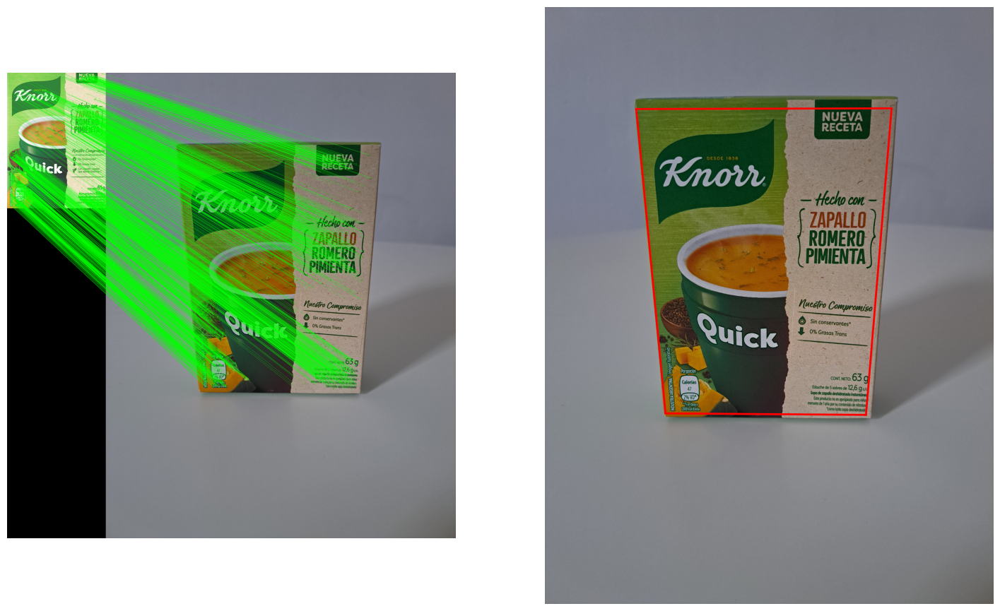

Imagen:  sopa_2.jpg
Se encontró el producto: Sopa


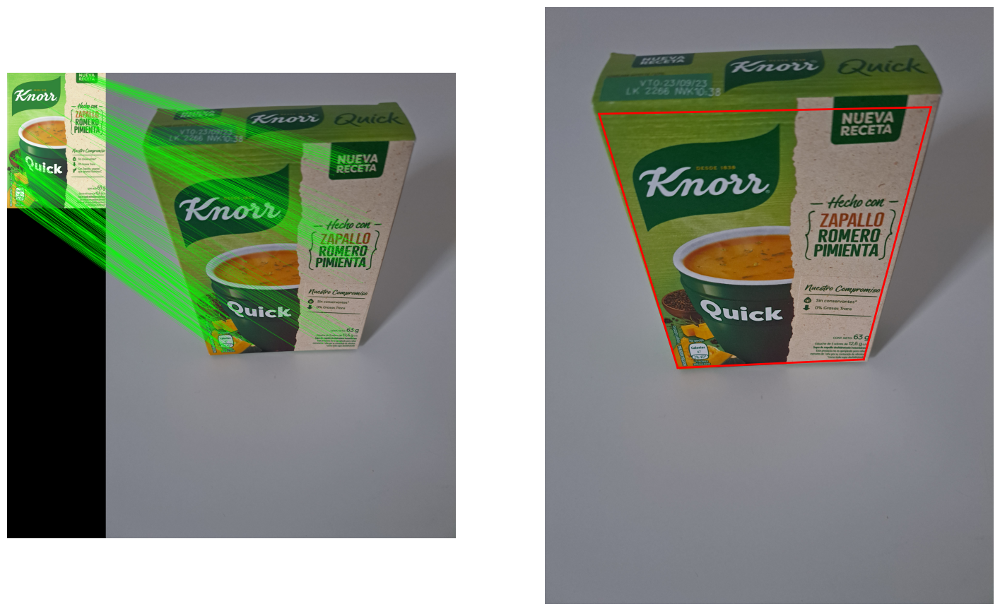

Imagen:  sopa_3.jpg
Se encontró el producto: Sopa


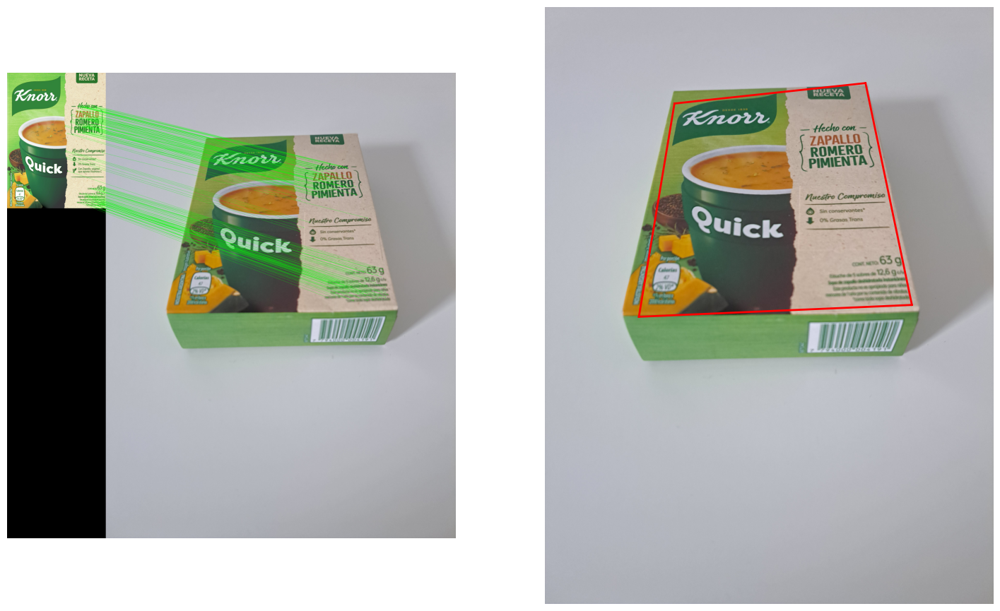

Imagen:  sopa_4.jpg
Se encontró el producto: Sopa


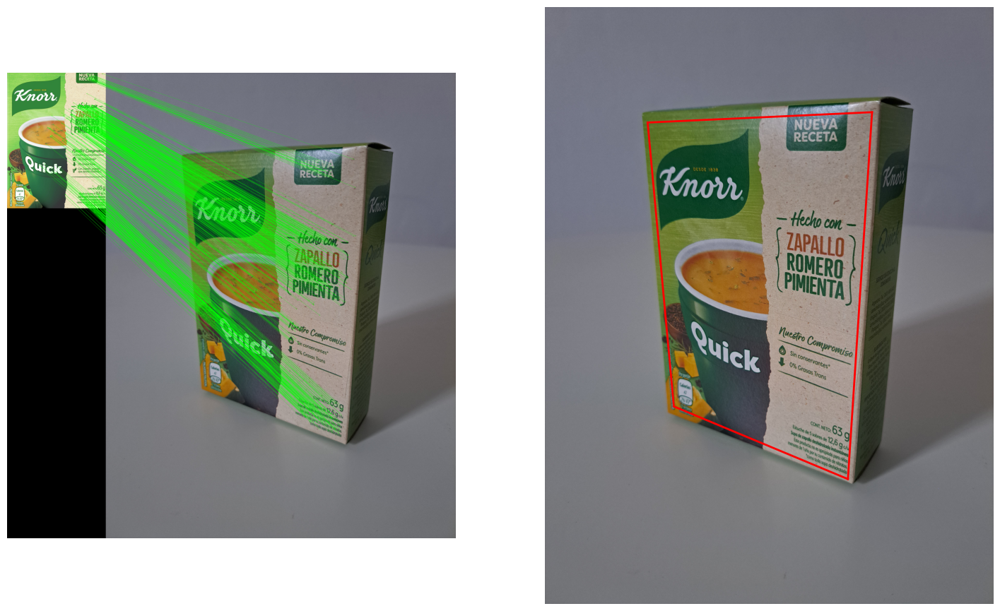

Imagen:  sopa_5.jpg
Se encontró el producto: Sopa


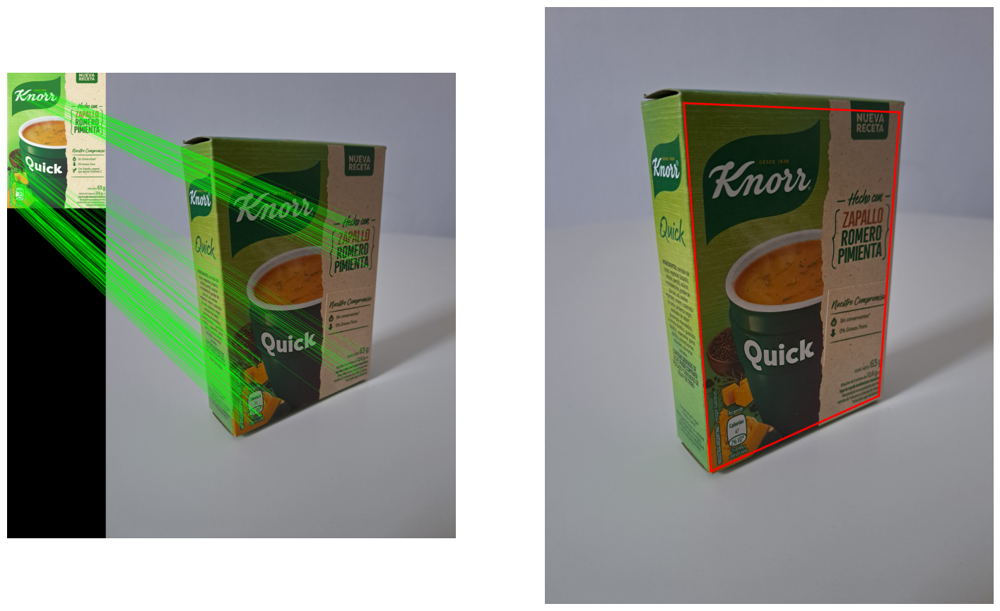

Imagen:  sopa_6.jpg
Se encontró el producto: Sopa


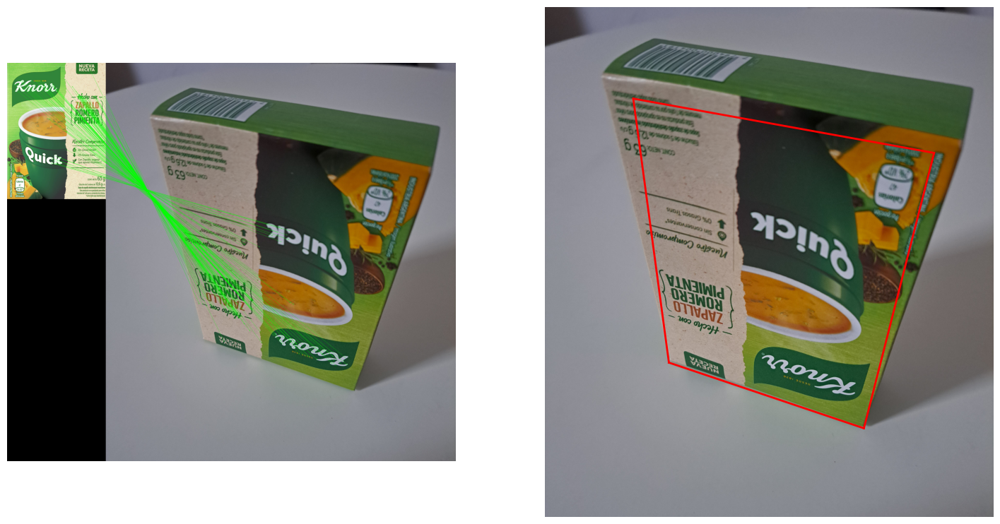

Imagen:  lluvia.jpg
No se encontró producto

Imagen:  atardecer_piso7.jpg
No se encontró producto



In [6]:
#Pongo las rutas de las imágenes a reconocer
imagenes_a_reconocer = ['imagenes/productos/imagenes_a_reconocer/sopa_1.jpg',
                        'imagenes/productos/imagenes_a_reconocer/sopa_2.jpg',
                        'imagenes/productos/imagenes_a_reconocer/sopa_3.jpg',
                        'imagenes/productos/imagenes_a_reconocer/sopa_4.jpg',
                        'imagenes/productos/imagenes_a_reconocer/sopa_5.jpg',
                        'imagenes/productos/imagenes_a_reconocer/sopa_6.jpg',
                        'imagenes/productos/imagenes_a_reconocer/lluvia.jpg',
                        'imagenes/productos/imagenes_a_reconocer/atardecer_piso7.jpg']

#LLamo a la función
identificar_producto(imagenes_a_reconocer)

### Con varios productos:

Imagen:  mis_productos_2.jpg
Se encontró el producto: Sopa


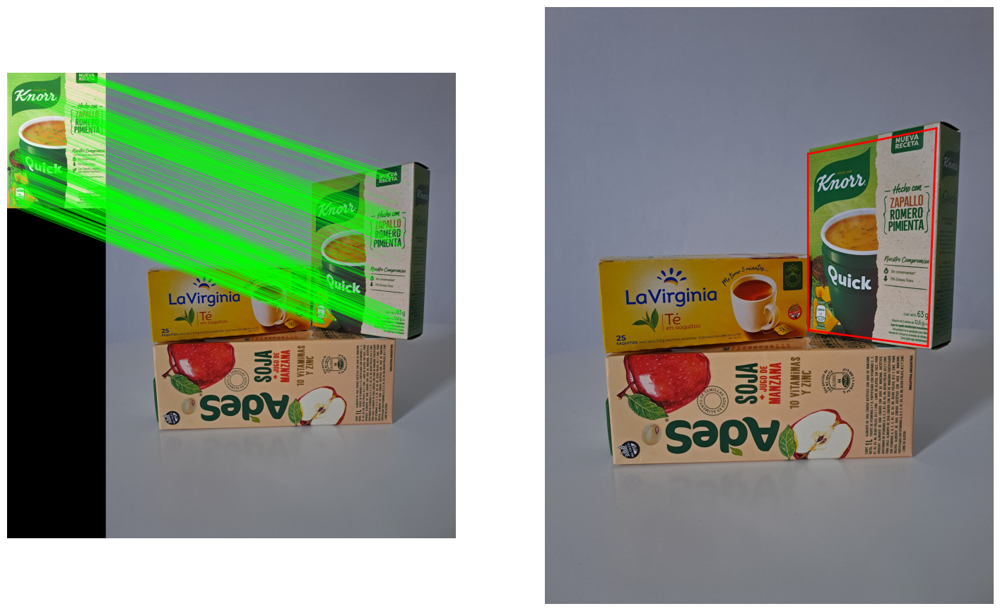

Se encontró el producto: La Virginia


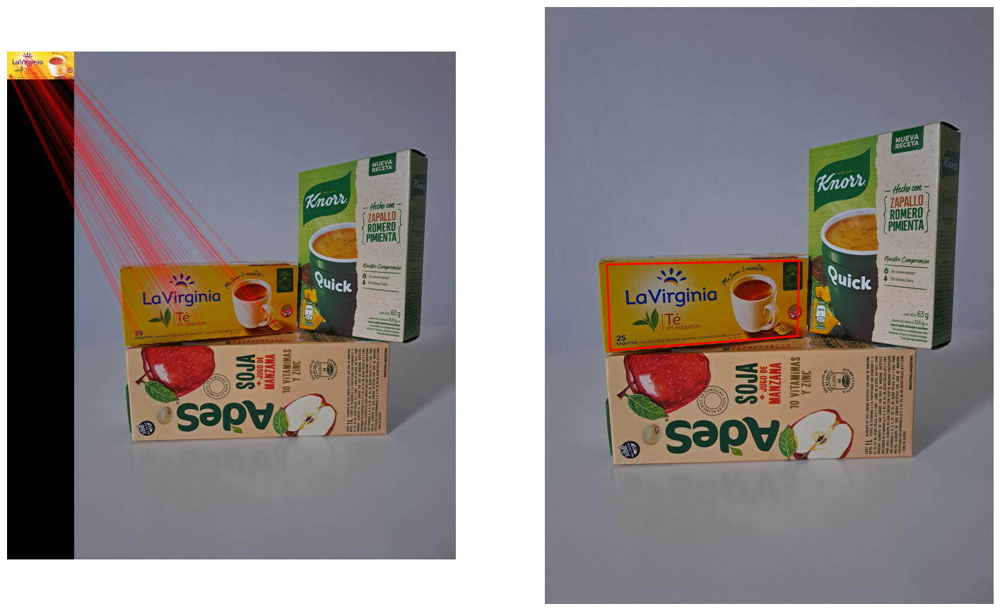

Se encontró el producto: Ades


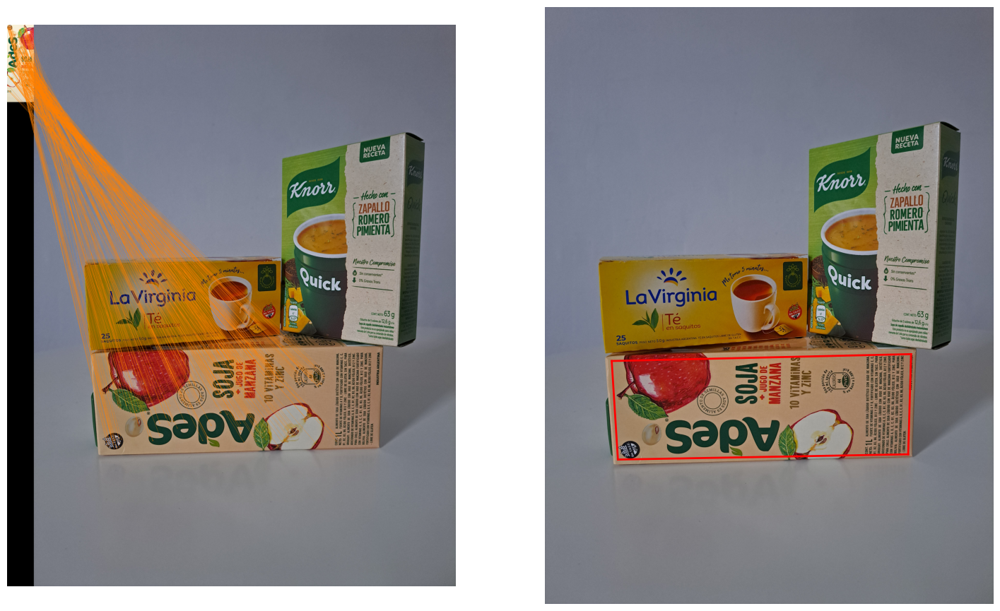

Imagen:  mis_productos_3.jpg
Se encontró el producto: Ruffles


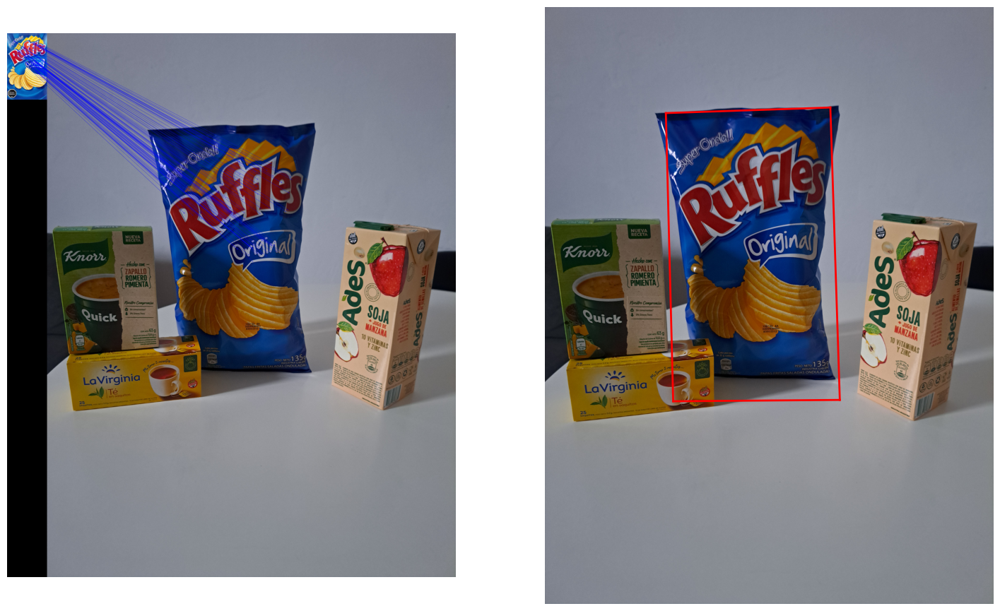

Se encontró el producto: Sopa


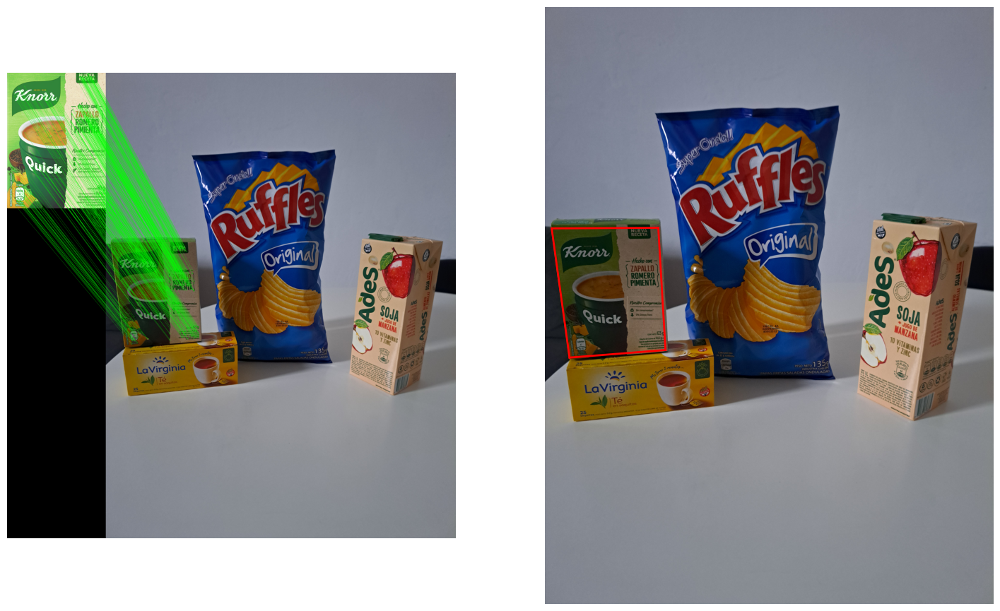

Se encontró el producto: La Virginia


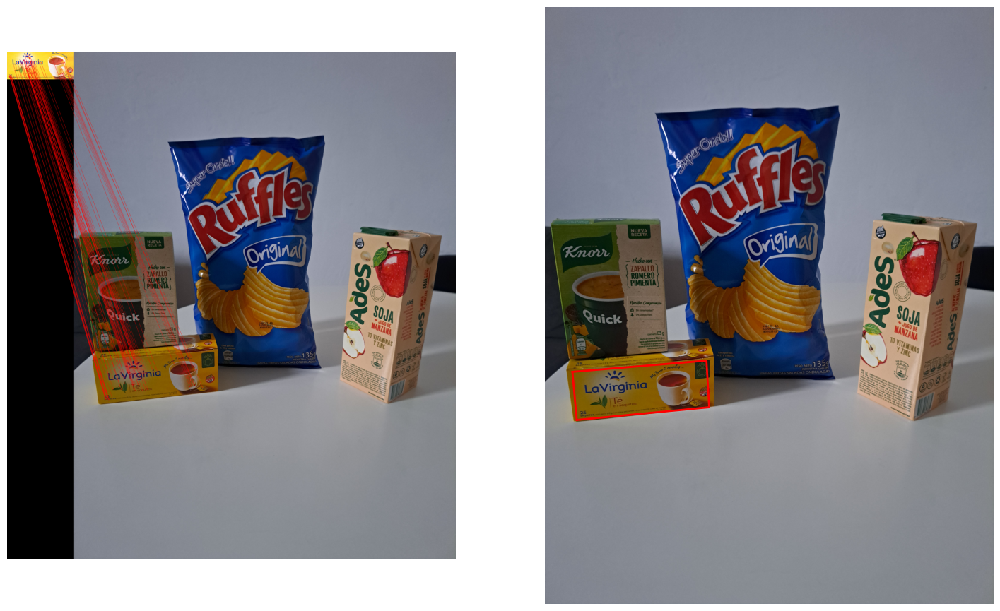

Se encontró el producto: Ades


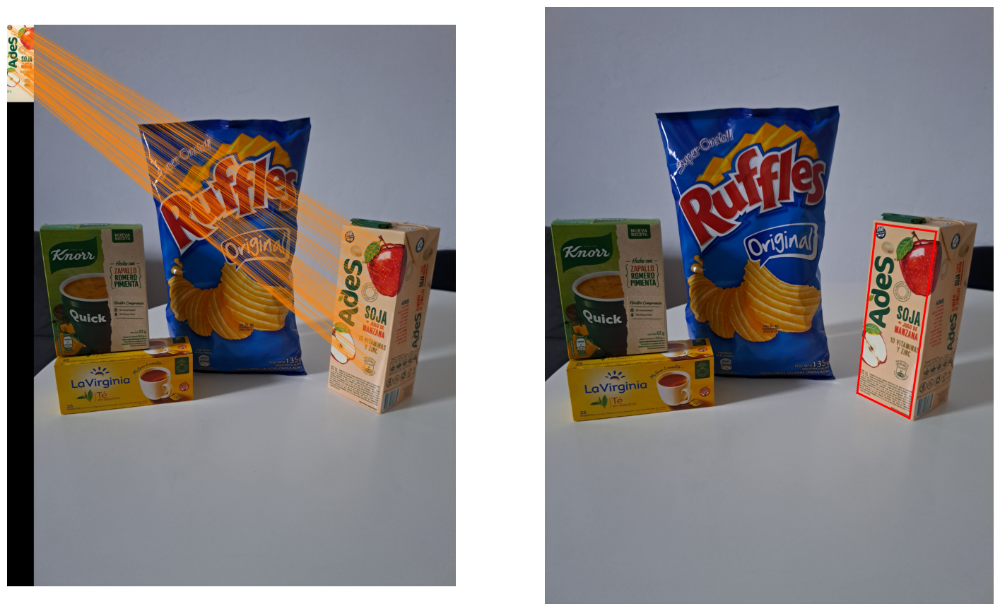

Imagen:  mis_productos_4.jpg
Se encontró el producto: Sopa


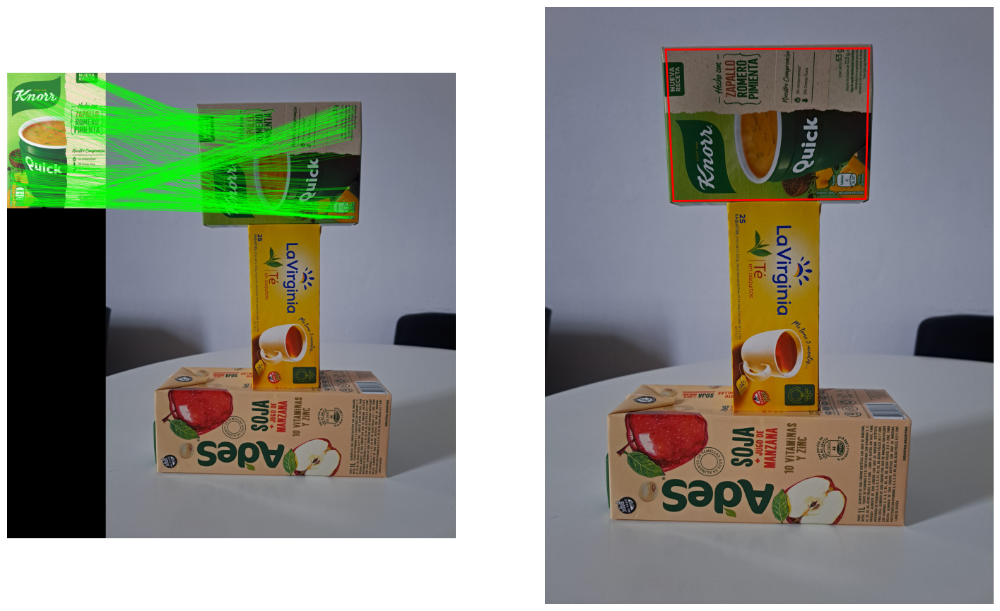

Se encontró el producto: La Virginia


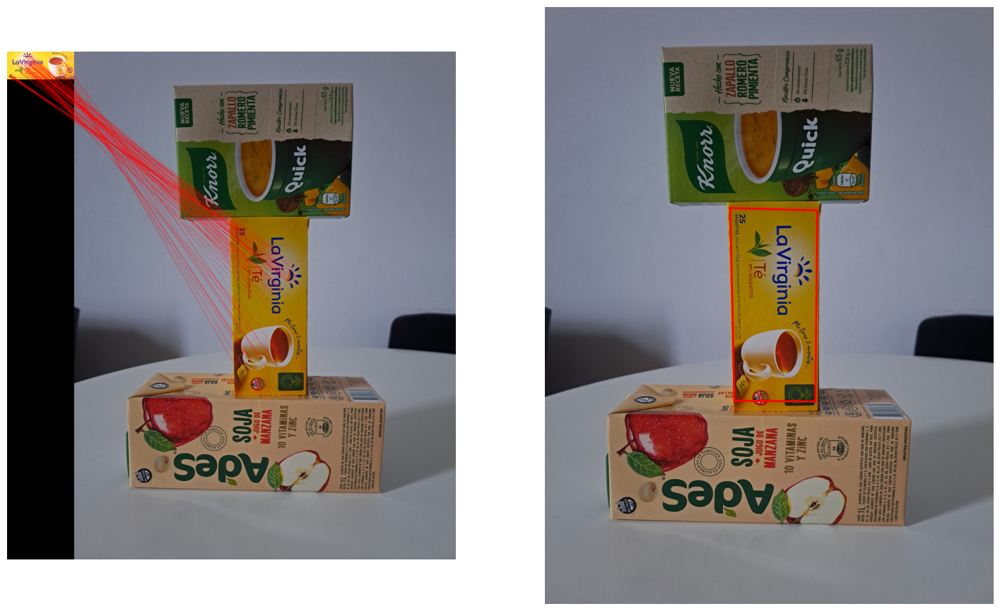

Se encontró el producto: Ades


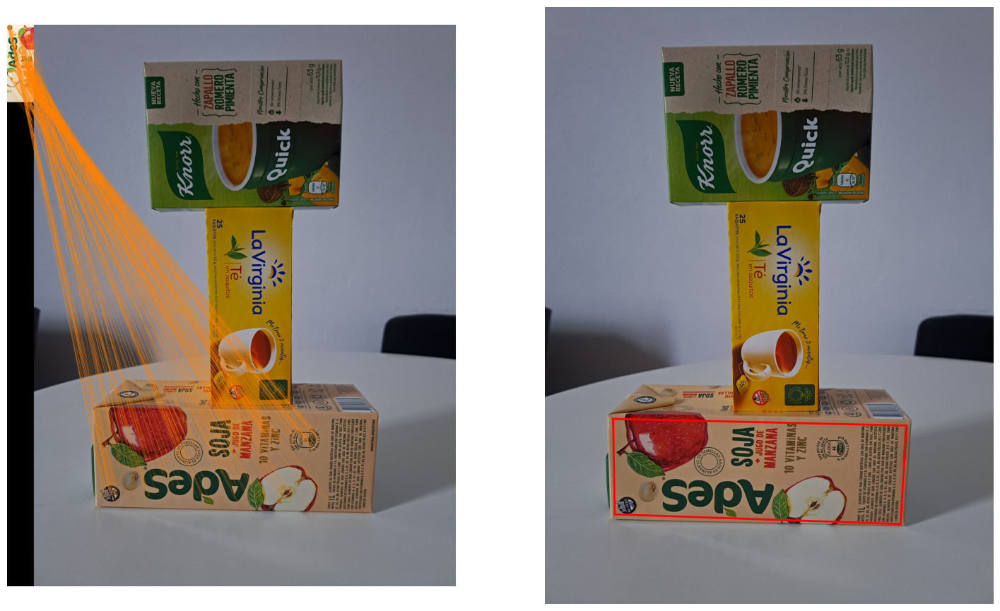

In [20]:
#Pongo las rutas de las imágenes a reconocer
imagenes_a_reconocer = ['imagenes/productos/imagenes_a_reconocer/mis_productos_2.jpg',
                        'imagenes/productos/imagenes_a_reconocer/mis_productos_3.jpg',
                        'imagenes/productos/imagenes_a_reconocer/mis_productos_4.jpg']


#LLamo a la función
identificar_producto(imagenes_a_reconocer)